# cellRank analysis - Sex differentiation - somatic male cells

Run STARsolo first to compute splicing/unsplicing counts


genome reference is at 

```
/nfs/srpipe_references/downloaded_from_10X/refdata-cellranger-GRCh38-3.0.0/genes/genes.gtf

```



In [1]:
import sys

import scvelo as scv
import scanpy as sc
import cellrank as cr
import numpy as np

import pandas as pd
import anndata
from scipy import sparse
    
scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo')
# cr.settings.verbosity = 2

import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

sc.logging.sinfo()
sc.settings.figdir = './figures-cellRank/male/'

-----
anndata     0.7.6
cellrank    1.5.1
numpy       1.21.1
pandas      1.3.1
scanpy      1.8.1
scipy       1.7.0
scvelo      0.2.4
-----
IPython             7.23.1
jupyter_client      6.1.12
jupyter_core        4.7.1
-----
Python 3.8.8 | packaged by conda-forge | (default, Feb 20 2021, 16:22:27) [GCC 9.3.0]
Linux-4.15.0-158-generic-x86_64-with-glibc2.10
60 logical CPU cores, x86_64
-----
Session information updated at 2022-02-07 13:36


In [2]:
def Barplot(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
#     ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
#                        dpi=300, orientation='landscape', format= 'pdf', optimize=True)

In [3]:
sample = 'FCA_GND8810851'

# Load data for sampel of interest

In [4]:
path_to_gonads = '/nfs/team292/lg18/with_valentina/gonadsV2_revision/'

In [5]:
adata = sc.read(path_to_gonads+'FCA-gonads_rawcounts.h5ad')

In [6]:
# Subset to sample of interest
adata = adata[[i in sample for i in adata.obs['sample']]]

In [7]:
# Add old cluster subname
metaF = pd.read_csv(path_to_gonads+'/FCA-gonads_somatic_annotated.csv')
metaF = metaF.set_index('Unnamed: 0')
metaF.head()

metaM = pd.read_csv(path_to_gonads+'/FCA-gonads_somaticEarly_annotated.csv')
metaM = metaM.set_index('Unnamed: 0')
metaM.head()


cell_annotM = metaM['celltype'].to_dict()
cell_annotF = metaF['celltype'].to_dict()
cell_annot = {**cell_annotF, **cell_annotM }
adata.obs['celltype'] = adata.obs_names.map(cell_annot).astype('category')
adata.obs['celltype'].values.describe()

Trying to set attribute `.obs` of view, copying.


,counts,freqs
categories,,
CoelEpi_GATA2,181,0.018142
CoelEpi_LHX9,105,0.010524
CoelEpi_LHX9_cycling,145,0.014533
Doublet,52,0.005212
Gi,143,0.014333
Sertoli,69,0.006916
cont,105,0.010524
early_sPAX8,185,0.018543
early_somatic,356,0.035682


In [8]:
# remove cycling cells and doublets
adata = adata[[ not pd.isna(i) for i in adata.obs['celltype'] ]]
adata = adata[[ i not in ['lowQC', 'Doublet', 'cont', 'CoelEpi_GATA2'] for i in adata.obs['celltype'] ]]
adata = adata[[not i for i in adata.obs.is_doublet]]
adata = adata[[ float(i) < 0.25 for i in adata.obs.scrublet_score  ]]
# adata = adata[[ 'cycling' not in i for i in adata.obs['celltype'] ]]
adata = adata[[ i in "G1" for i in adata.obs.phase]]

In [9]:
counts = adata.obs['celltype'].values.describe()
counts

,counts,freqs
categories,,
CoelEpi_LHX9,55,0.062288
CoelEpi_LHX9_cycling,2,0.002265
Gi,103,0.116648
Sertoli,51,0.057758
early_sPAX8,152,0.172140
early_somatic,336,0.380521
early_supporting,147,0.166478
preGC_I,37,0.041903


In [10]:
from itertools import compress
cellsOfInterest = list(compress(counts.index, counts.counts > 50))
adata = adata[[i in cellsOfInterest for i in adata.obs.celltype]]
adata.obs['celltype'].values.describe()

,counts,freqs
categories,,
CoelEpi_LHX9,55,0.065166
Gi,103,0.122038
Sertoli,51,0.060427
early_sPAX8,152,0.180095
early_somatic,336,0.398104
early_supporting,147,0.174171


# Process somatic cells of interest and get the manifold

In [11]:
# Shall we filter cells?
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

Trying to set attribute `.obs` of view, copying.


In [12]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=2000,
    subset=False,
    flavor="seurat_v3"
)

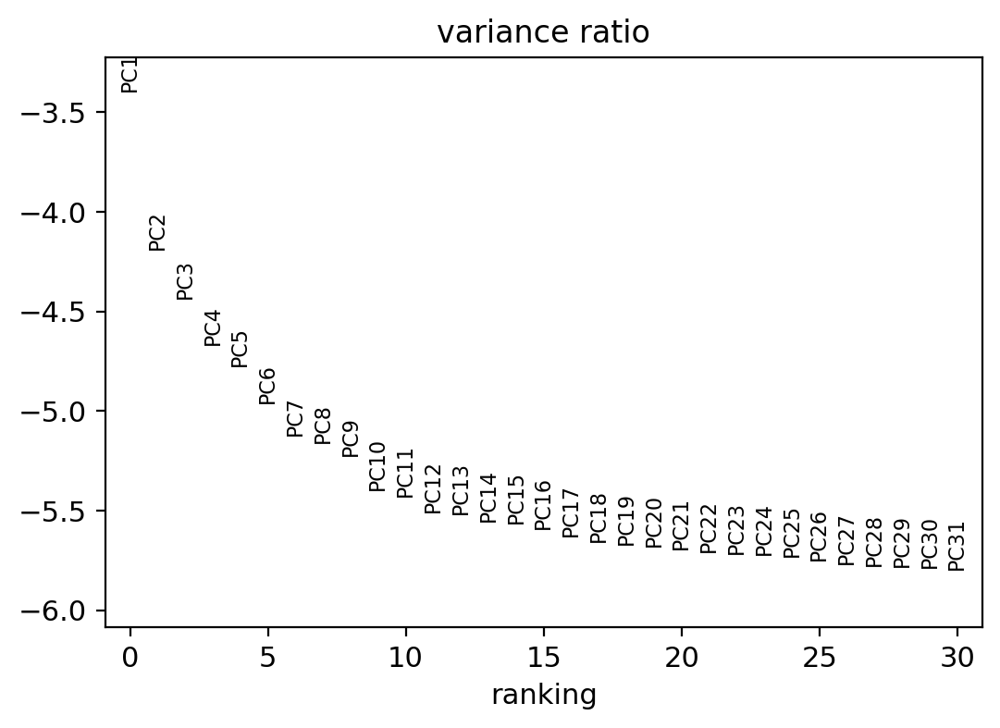

In [13]:
adata.raw = adata.copy()
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)
# Regress out cycling scores
# sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
sc.tl.pca(adata, svd_solver='arpack', n_comps=50)
sc.pl.pca_variance_ratio(adata, log=True)

In [14]:
n_pcs = 9
sc.pp.neighbors(adata, n_pcs = n_pcs, random_state=1)
sc.tl.umap(adata)

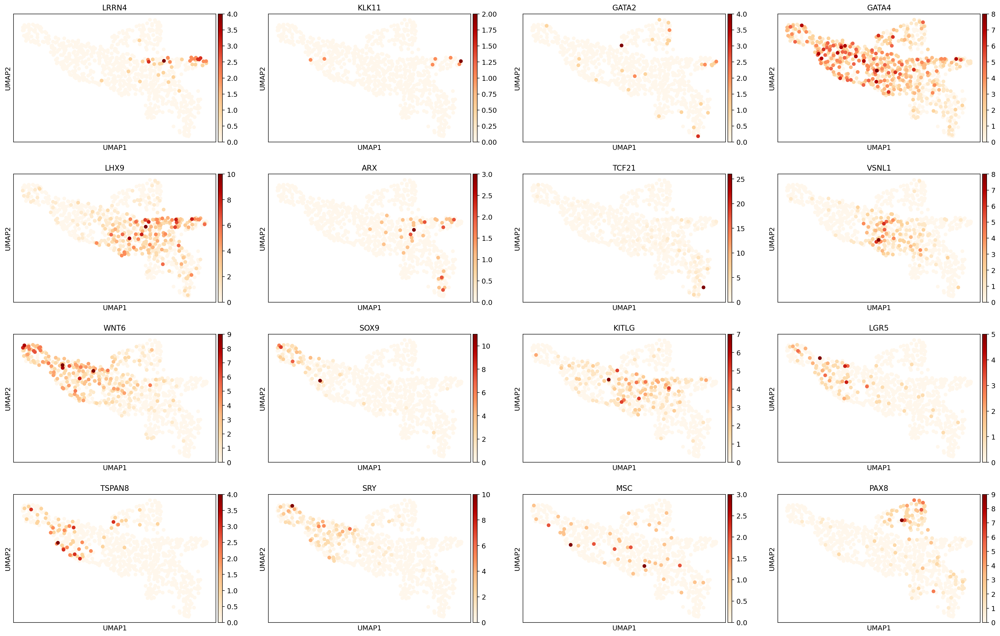

In [15]:
sc.pl.umap(adata, color=['LRRN4', 'KLK11', 'GATA2', 'GATA4' , 'LHX9', 'ARX', 'TCF21', 'VSNL1', 'WNT6', 'SOX9', 'KITLG',  'LGR5', 'TSPAN8','SRY', 'MSC',  'PAX8'], color_map='OrRd')

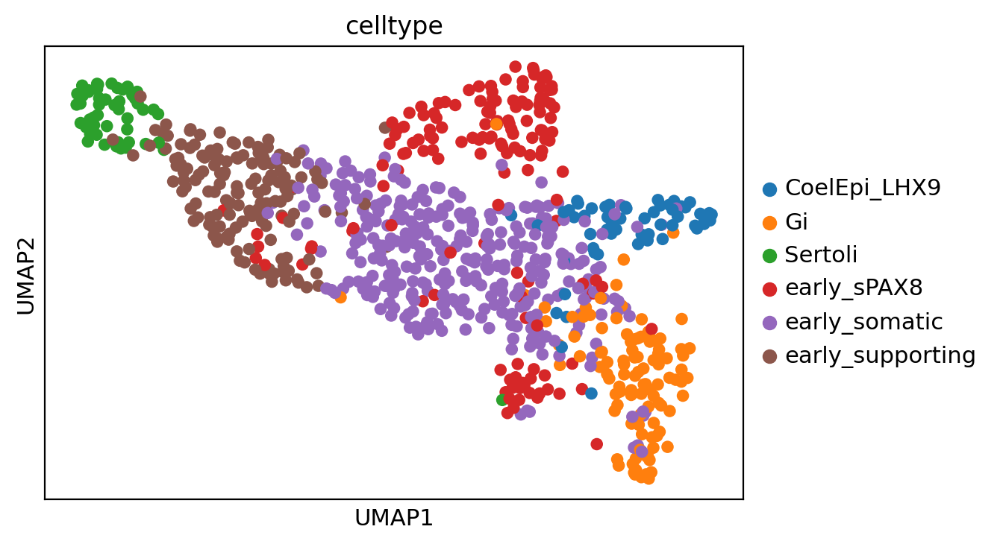

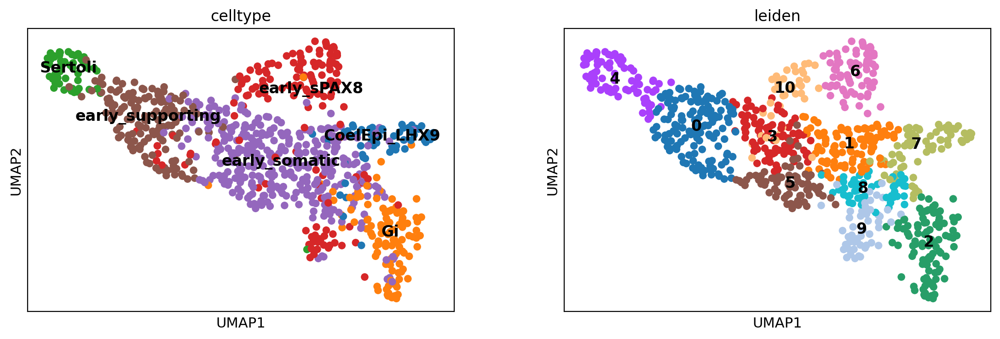

In [16]:
sc.tl.leiden(adata, resolution=1)
sc.pl.umap(adata, color=['celltype'])
sc.pl.umap(adata, color=['celltype', 'leiden'],legend_loc='on data')

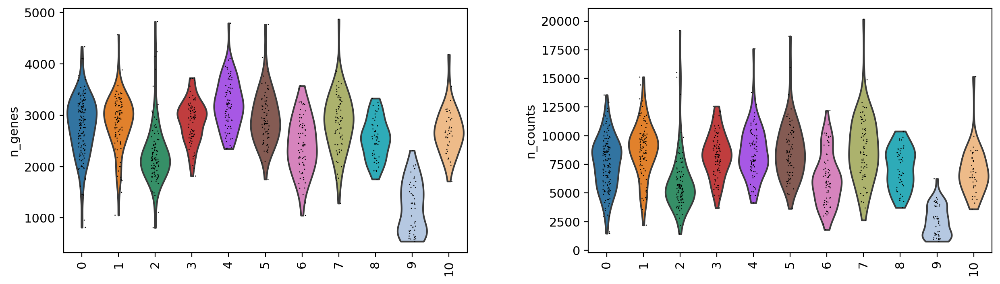

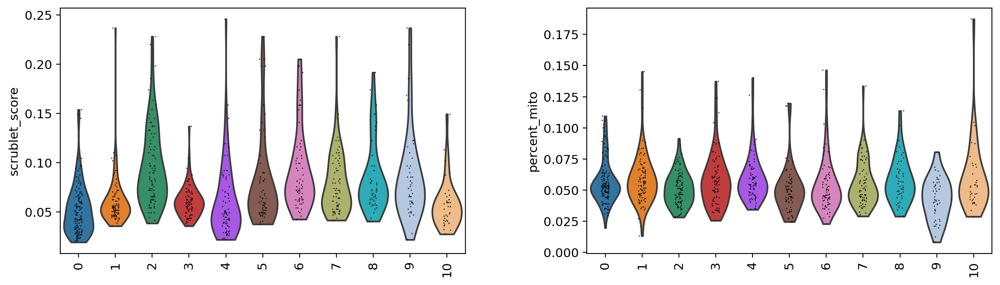

In [17]:
sc.pl.violin(adata, ['n_genes', 'n_counts'], groupby='leiden', rotation=90)
sc.pl.violin(adata, ['scrublet_score', 'percent_mito'], groupby='leiden', rotation=90)

## re-process somatic cells of interest and get the manifold 
Remove lowQC/extragonadal clusters

In [18]:
#  remove lowQC cluster
adata = adata[[ i not in ['9'] for i in adata.obs.leiden ]]
adata = anndata.AnnData(X=adata.raw.X, var=adata.raw.var, obs=adata.obs, asview=False)

In [19]:
adata.obs.celltype =  [ i.replace('_cycling', '') for i in adata.obs.celltype ]
adata.obs.celltype =  adata.obs.celltype.astype("category")

In [20]:
# Shall we filter cells?
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

In [21]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=2000,
    subset=False,
    flavor="seurat_v3"
)

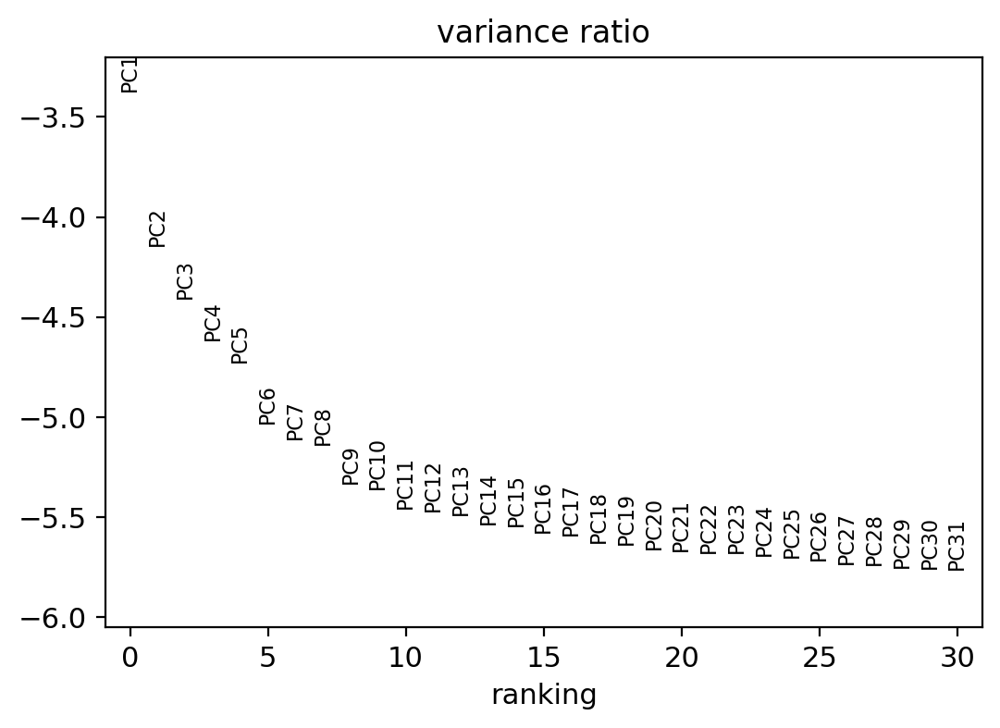

In [22]:
adata.raw = adata.copy()
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)
# # Regress out cycling scores
# sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
sc.tl.pca(adata, svd_solver='arpack', n_comps=50)
sc.pl.pca_variance_ratio(adata, log=True)

In [23]:
n_pcs = 10
sc.pp.neighbors(adata, n_pcs = n_pcs, random_state=1)
sc.tl.umap(adata)

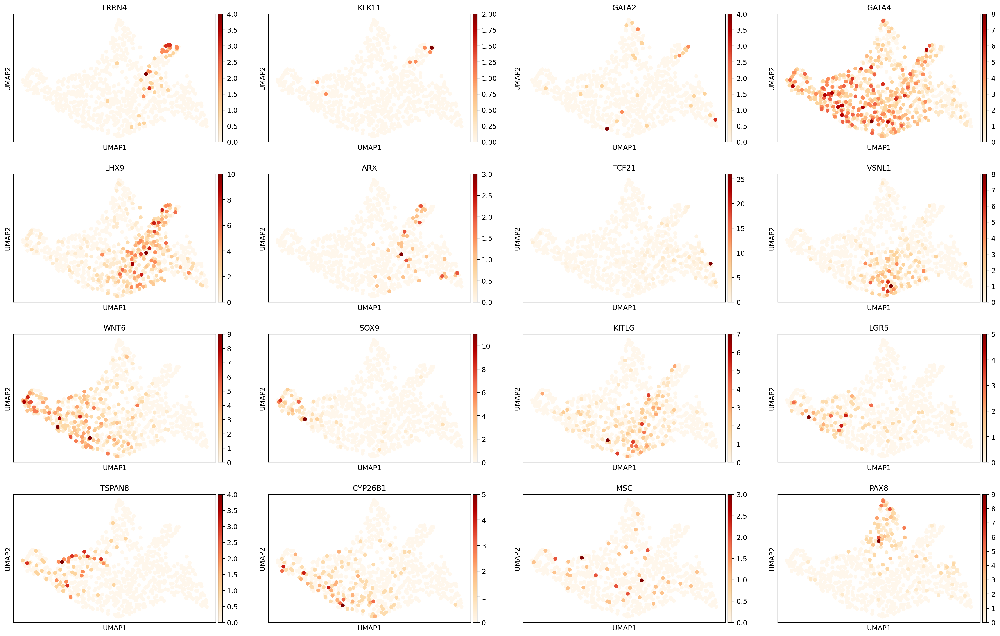

In [24]:
sc.pl.umap(adata, color=['LRRN4', 'KLK11', 'GATA2', 'GATA4' , 'LHX9', 'ARX', 'TCF21', 'VSNL1', 'WNT6', 'SOX9', 'KITLG',  'LGR5', 'TSPAN8','CYP26B1', 'MSC',  'PAX8'], color_map='OrRd')

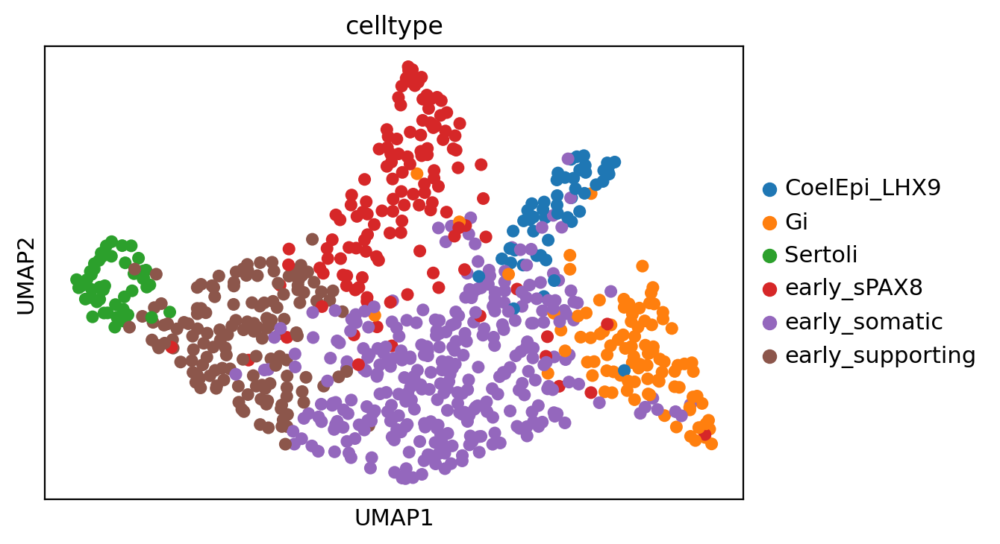

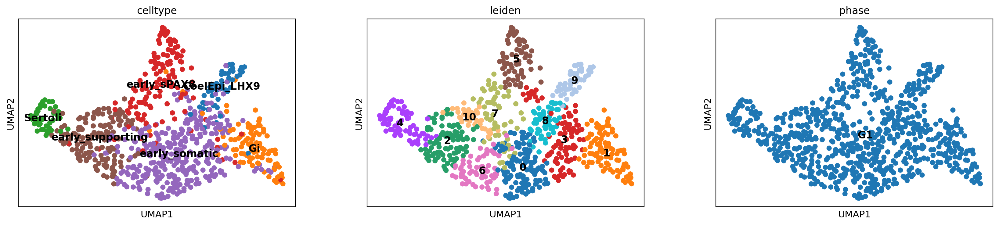

In [25]:
sc.tl.leiden(adata, resolution=1)
sc.pl.umap(adata, color=['celltype'])
sc.pl.umap(adata, color=['celltype', 'leiden', 'phase'],legend_loc='on data')

In [26]:
colorsSom_df = pd.read_csv('gonads_somatic_colors.csv',index_col=0)
colorsSom_df
idx = [colorsSom_df.index.tolist().index(i) for i in adata.obs['celltype'].cat.categories.tolist() ]
adata.uns['celltype_colors'] = [ colorsSom_df.color[i] for i in idx ]
adata.uns['clusters_colors'] = [ colorsSom_df.color[i] for i in idx ]

In [27]:
adata.obs['clusters'] = adata.obs['celltype']

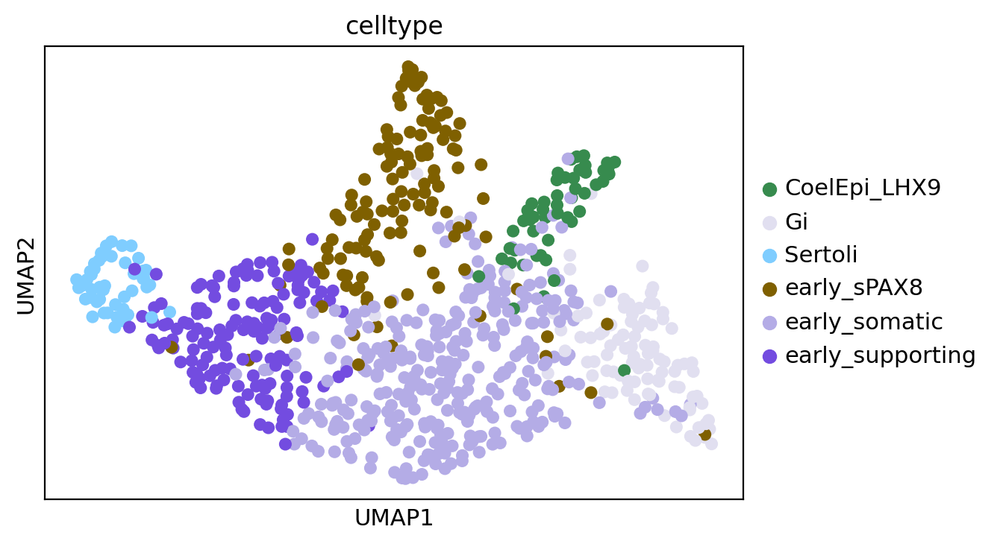

In [28]:
sc.pl.umap(adata, color=['celltype'])

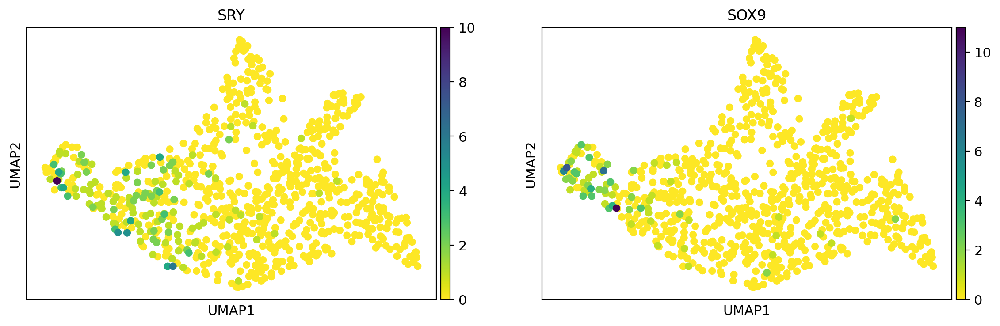

In [29]:
sc.pl.umap(adata, color=['SRY', 'SOX9'], color_map='viridis_r', save='SRY_Hrv17.pdf')

# Load velocyto results

In [30]:
def read_starsolo_velocyto(path):
    '''load_adata is a repertory which contains all of our barcodes file, features file and matrix file'''

    adata = sc.read(path+'Gene/filtered/matrix.mtx.gz').T
    genes = pd.read_csv(path+'Gene/filtered/genes.tsv.gz', header=None, sep='\t')
    adata.var_names = genes[1]
    adata.var['ensembl'] = genes[0].values
    adata.obs_names = pd.read_csv(path+'Gene/filtered/barcodes.tsv.gz', header=None)[0]

#     adata = sc.read_10x_mtx(path+'Gene/filtered/', cache_compression=None)

    spliced = np.loadtxt(path+'Velocyto/filtered/spliced.mtx.gz', skiprows=3, delimiter=' ')
    shape = np.loadtxt(path+'Velocyto/filtered/spliced.mtx.gz', skiprows=2, max_rows = 1 ,delimiter=' ')[0:2].astype(int)
    adata.layers['spliced']=sparse.csr_matrix((spliced[:,2], (spliced[:,0]-1, spliced[:,1]-1)), shape = (shape)).tocsr().T

    unspliced = np.loadtxt(path+'Velocyto/filtered/unspliced.mtx.gz', skiprows=3, delimiter=' ')
    adata.layers['unspliced']=sparse.csr_matrix((unspliced[:,2], (unspliced[:,0]-1, unspliced[:,1]-1)), shape = (shape)).tocsr().T

    ambiguous = np.loadtxt(path+'Velocyto/filtered/ambiguous.mtx.gz', skiprows=3, delimiter=' ')
    adata.layers['ambiguous']=sparse.csr_matrix((ambiguous[:,2], (ambiguous[:,0]-1, ambiguous[:,1]-1)), shape = (shape)).tocsr().T

    return adata

In [31]:
path = '/warehouse/cellgeni/tic-1082/human/'+sample+'/output/'
adataV = read_starsolo_velocyto(path)
scv.utils.show_proportions(adataV)
adataV

Abundance of ['spliced', 'unspliced']: [0.88 0.12]


AnnData object with n_obs × n_vars = 14578 × 33538
    var: 'ensembl'
    layers: 'spliced', 'unspliced', 'ambiguous'

In [32]:
a = np.array(adataV.layers['ambiguous'].todense()).sum()
s = np.array(adataV.layers['spliced'].todense()).sum()
u = np.array(adataV.layers['unspliced'].todense()).sum()
print(a/(a+s+u))
print(s/(a+s+u))
print(u/(a+s+u))

0.08008208799256003
0.8169950697681592
0.10292284223928086


In [33]:
adataV

AnnData object with n_obs × n_vars = 14578 × 33538
    var: 'ensembl'
    layers: 'spliced', 'unspliced', 'ambiguous'

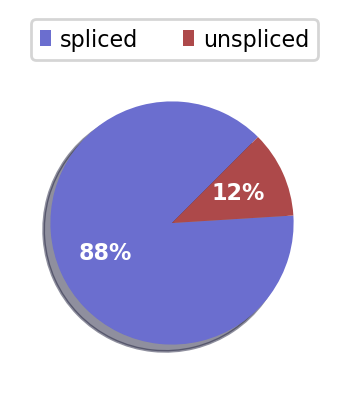

Abundance of ['spliced', 'unspliced']: [0.88 0.12]


In [34]:
scv.pl.proportions(adataV, highlight = 'ambiguous')
scv.utils.show_proportions(adataV)

In [35]:
# Format cell sample id and use as index
adataV.obs['sample'] = adataV.obs.index
adataV.obs['sample'] = [sample+'_'+i  for i in adataV.obs['sample']]
# adataV.obs['sample'] = [i.replace('x', '')  for i in adataV.obs['sample'] ]
# adataV.obs['sample'] = [i.replace(':', '_')  for i in adataV.obs['sample']]
adataV.obs.index = adataV.obs['sample'] 

## add velocyto into the  object

In [36]:
adataN = scv.utils.merge(adata, adataV)

print('Total number of cells: {:d}'.format(adataN.n_obs))
print('Total number of genes: {:d}'.format(adataN.n_vars))
scv.utils.show_proportions(adataN)

Total number of cells: 796
Total number of genes: 15731
Abundance of ['spliced', 'unspliced']: [0.88 0.12]


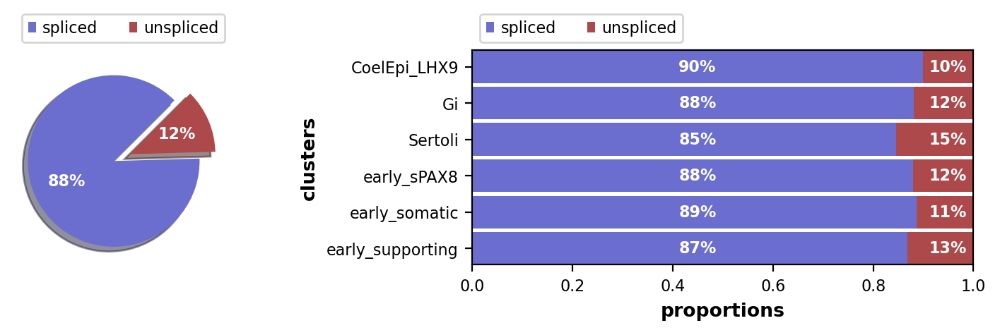

In [37]:
scv.pl.proportions(adataN)

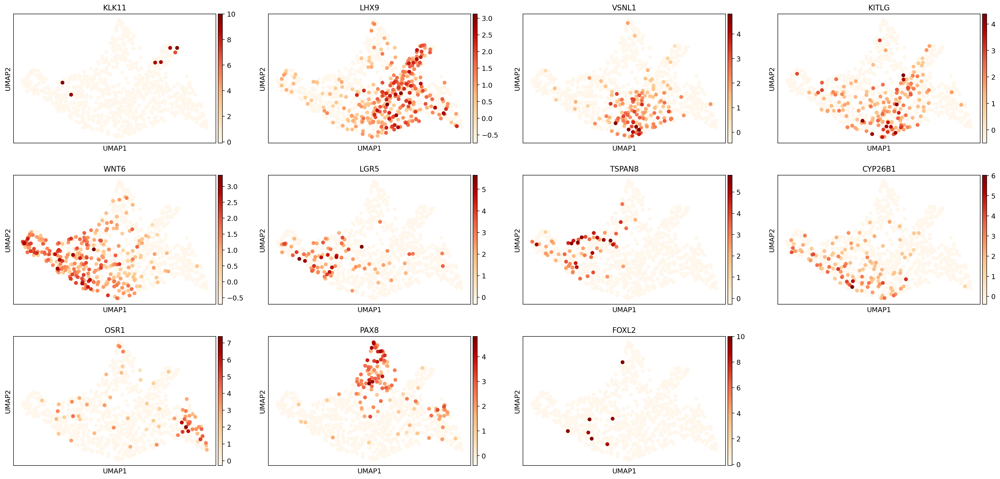

In [38]:
sc.pl.umap(adata, color=['KLK11', 'LHX9',  'VSNL1', 'KITLG', 'WNT6', 'LGR5', 'TSPAN8','CYP26B1', 'OSR1',  'PAX8', 'FOXL2'], color_map='OrRd', use_raw=False)

In [39]:
# compute first and second order moments (means and uncentered variances) computed among nearest neighbors in PCA space,
scv.pp.moments(adataN, n_pcs=n_pcs, use_highly_variable=True)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


# Run scVelo: Stochastic velocity

In [40]:
# scv.tl.recover_dynamics(adataN)
scv.tl.velocity(adataN, mode='stochastic') # mode : ‘deterministic’, ‘stochastic’ or ‘dynamical’ (default: ‘stochastic’)
scv.tl.velocity_graph(adataN)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/60 cores)
or disable the progress bar using `show_progress_bar=False`.
    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo__Hrv17_velocity_arrows_Ilabels.png


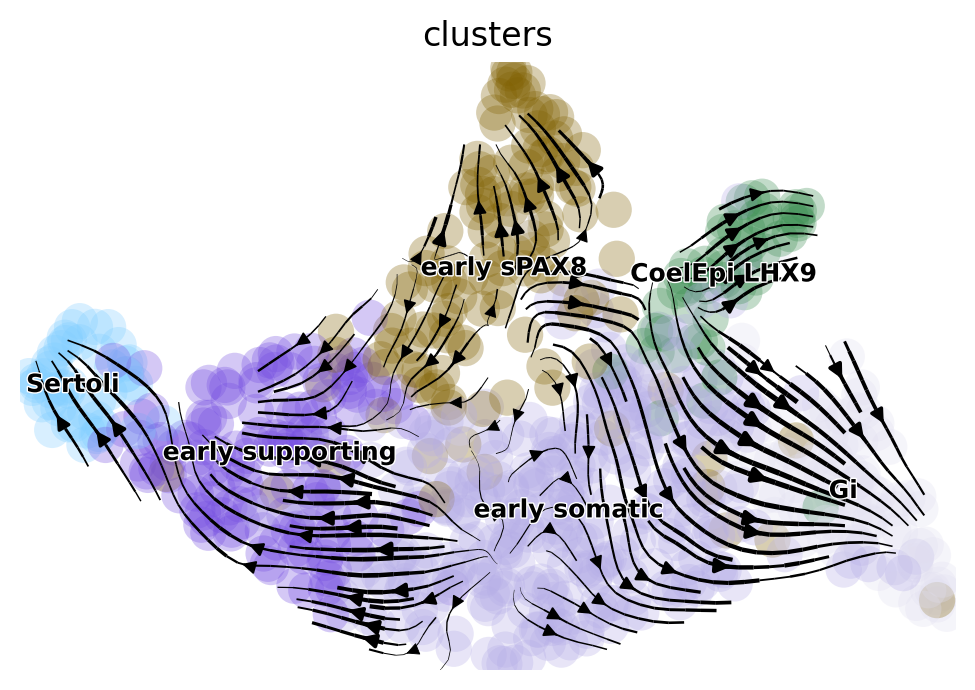

saving figure to file ./figures/scvelo__Hrv17_velocity_arrows_I.png


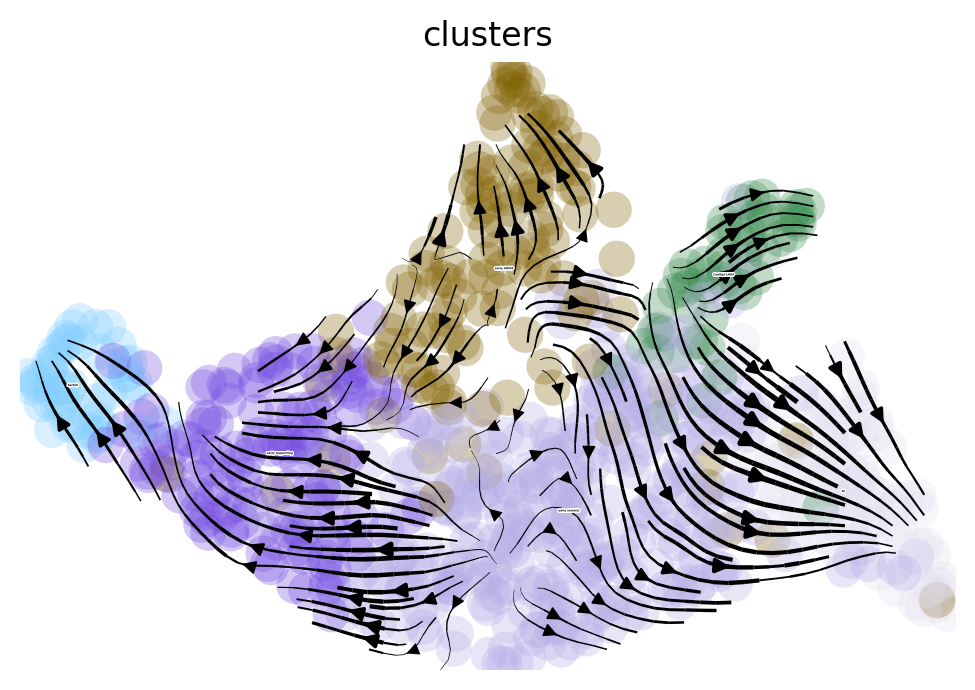

saving figure to file ./figures/scvelo__Hrv17_velocity_arrows_II.pdf


In [41]:
scv.pl.velocity_embedding_stream(adataN, basis='umap', smooth=.8, min_mass=4, color='clusters', palette=adata.uns['celltype_colors'], legend_fontsize=9,  save= '_Hrv17_velocity_arrows_Ilabels.png')
scv.pl.velocity_embedding_stream(adataN, basis='umap', smooth=.8, min_mass=4, color='clusters', palette=adata.uns['celltype_colors'], legend_fontsize=0,  save= '_Hrv17_velocity_arrows_I.png')
scv.pl.velocity_embedding(adataN, arrow_length=5, arrow_size=3, dpi=300,  figsize=(20,17), save= '_Hrv17_velocity_arrows_II.pdf')

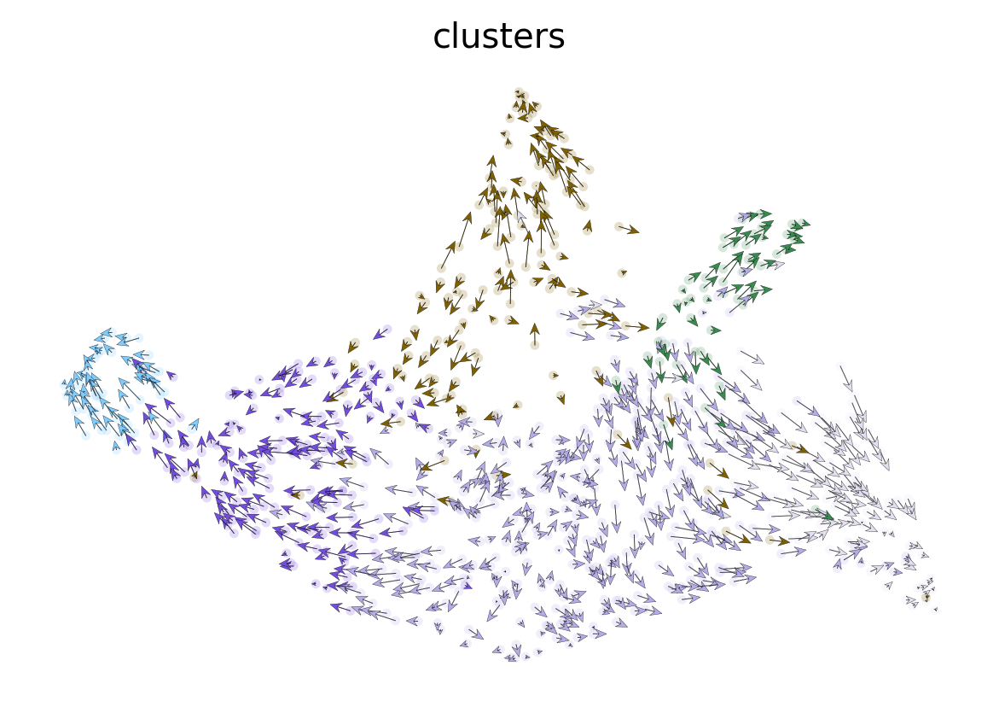

In [42]:
scv.pl.velocity_embedding(adataN, arrow_length=3, arrow_size=2, dpi=120)

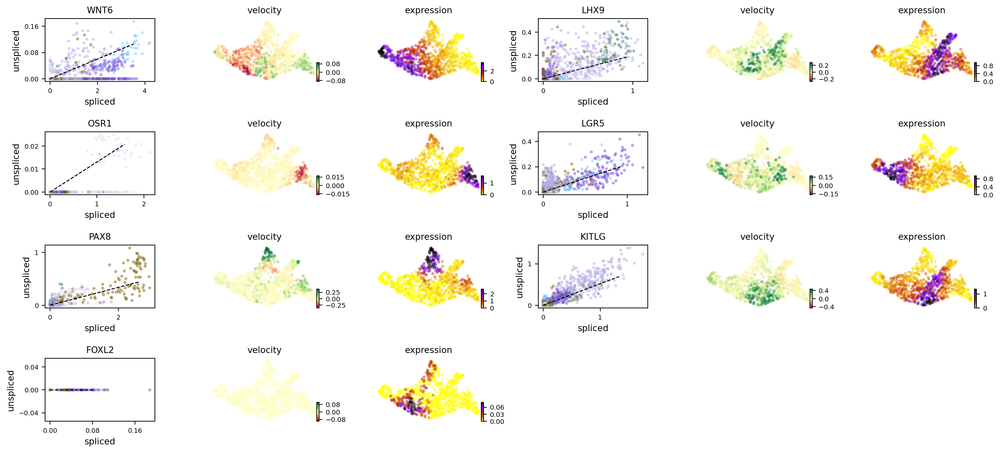

In [43]:
scv.pl.velocity(adataN, var_names=["WNT6", "LHX9", 'LHX2', 'OSR1', 'LGR5', 'PAX8', 'KITLG', 'FOXL2'], ncols=2)

# Run CellRank

CellRank offers various ways to infuse directionality into single-cell data. Here, the directional information comes from RNA velocity, and we use this information to compute initial & terminal states as well as fate probabilities for the stochastic process of gonadal development.

### Identify terminal states

In [44]:
cr.tl.terminal_states(adataN, cluster_key="clusters", weight_connectivities=0.2, n_states=3)

<ipython-input-44-03d27585a65a>:1: DeprecationWarning: `cellrank.tl.terminal_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.terminal_states(adataN, cluster_key="clusters", weight_connectivities=0.2, n_states=3)
/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(
100%|██████████| 796/796 [00:00<00:00, 981.20cell/s] 


The most important parameters in the above function are:

- estimator: this determines what’s going to behind the scenes to compute the terminal states. Options are cr.tl.estimators.CFLARE (“Clustering and Filtering of Left and Right Eigenvectors”) or cr.tl.estimators.GPCCA (“Generalized Perron Cluster Cluster Analysis, [Reuter et al., 2018] and [Reuter et al., 2019], see also our pyGPCCA implementation). The latter is the default, it computes terminal states by coarse graining the velocity-derived Markov chain into a set of macrostates that represent the slow-time scale dynamics of the process, i.e. it finds the states that you are unlikely to leave again, once you have entered them.

- cluster_key: takes a key from adata.obs to retrieve pre-computed cluster labels, i.e. ‘clusters’ or ‘louvain’. These labels are then mapped onto the set of terminal states, to associate a name and a color with each state.

- n_states: number of expected terminal states. This parameter is optional - if it’s not provided, this number is estimated from the so-called ‘eigengap heuristic’ of the spectrum of the transition matrix.

- method: This is only relevant for the estimator GPCCA. It determines the way in which we compute and sort the real Schur decomposition. The default, krylov, is an iterative procedure that works with sparse matrices which allows the method to scale to very large cell numbers. It relies on the libraries SLEPc and PETSc, which you will have to install separately, see our installation instructions. If your dataset is small (<5k cells), and you don’t want to install these at the moment, use method='brandts' [Brandts, 2002]. The results will be the same, the difference is that brandts works with dense matrices and won’t scale to very large cells numbers.

 - weight_connectivities: weight given to cell-cell similarities to account for noise in velocity vectors.

When running the above command, CellRank adds a key terminal_states to adata.obs and the result can be plotted as:

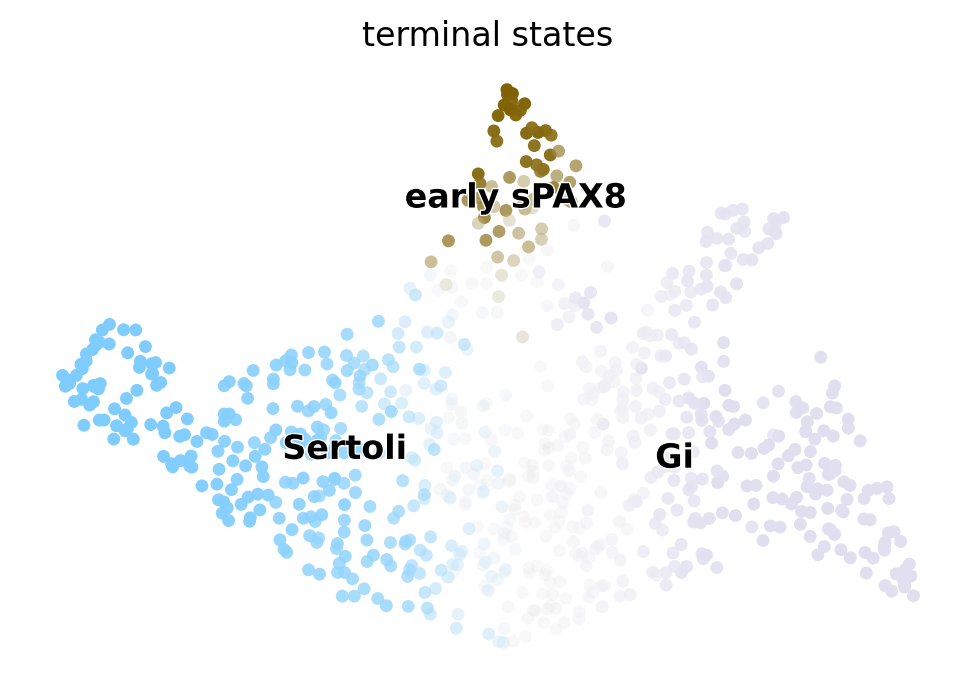

In [45]:
cr.pl.terminal_states(adataN)

### Identify initial states

The same sort of analysis can now be repeated for the initial states, only that we use the function cr.tl.initial_states this time:

/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-46-8b7cb2688383>:1: DeprecationWarning: `cellrank.tl.initial_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.initial_states(adataN, cluster_key="clusters")
/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(
100%|██████████| 796/796 [00:00<00:00, 2305.61cell/s]


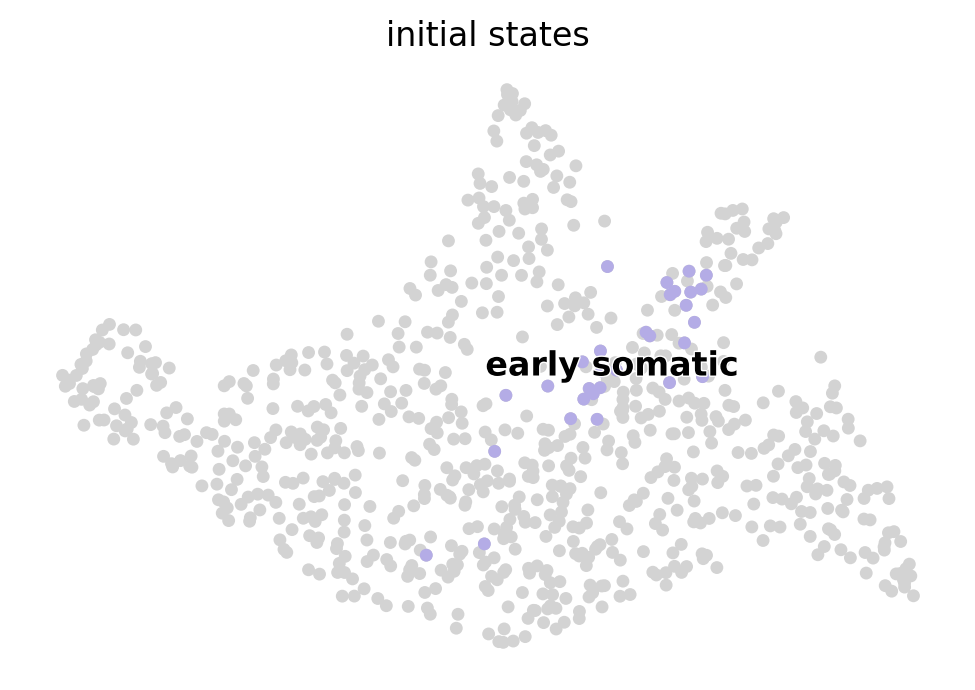

In [46]:
cr.tl.initial_states(adataN, cluster_key="clusters")
cr.pl.initial_states(adataN, discrete=True)

### Compute fate maps

Once we know the terminal states, we can compute associated fate maps - for each cell, we ask how likely is the cell to develop towards each of the identified terminal states.

/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-47-61e0a1fc9b7f>:1: DeprecationWarning: `cellrank.tl.lineages` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineages(adataN)
100%|██████████| 3/3 [00:00<00:00, 30.85/s]


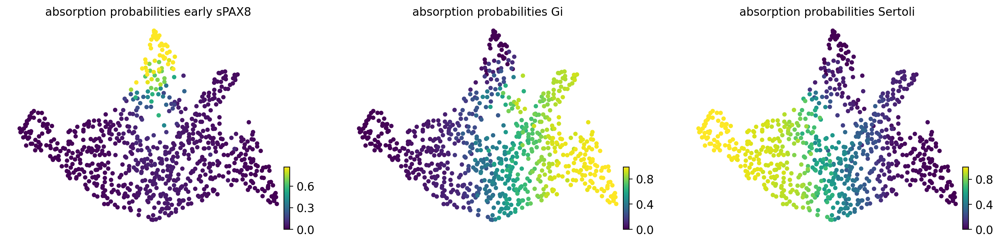

In [47]:
cr.tl.lineages(adataN)
cr.pl.lineages(adataN, same_plot=False)

/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


saving figure to file ./figures/scvelo__Hrv17_cellRank_absortionProbs.pdf


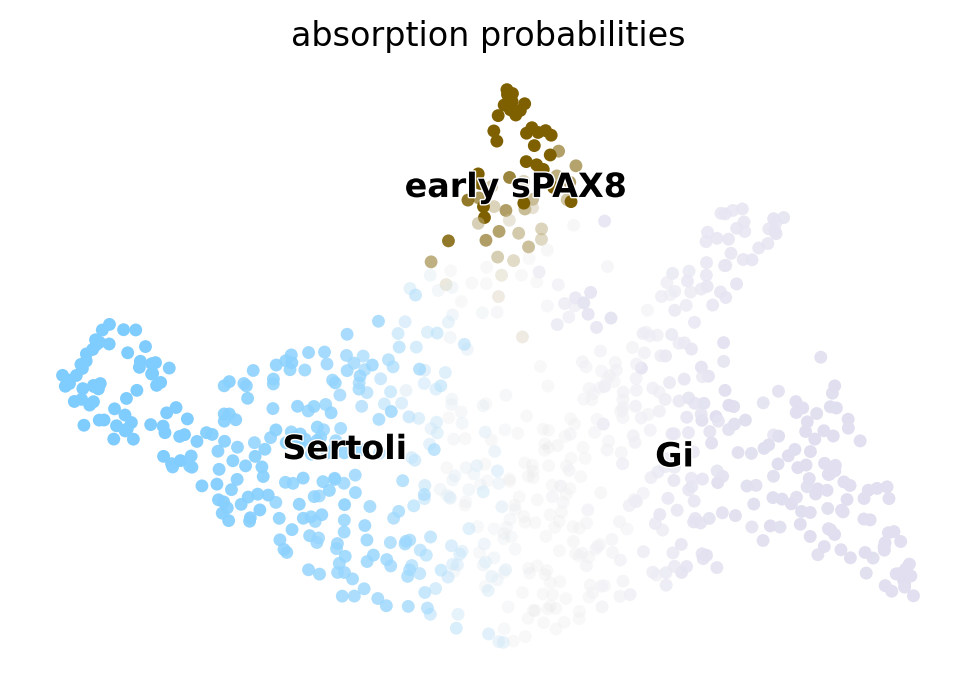

In [48]:
cr.pl.lineages(adataN, same_plot=True, save='_Hrv17_cellRank_absortionProbs.pdf')

We first compute scVelo’s latent time with CellRank identified root_key and end_key, which are the probabilities of being an initial or a terminal state, respectively.

In [49]:
scv.tl.recover_dynamics(adataN)
scv.tl.recover_latent_time(
    adataN, root_key="initial_states_probs", end_key="terminal_states_probs"
)

recovering dynamics (using 1/60 cores)


/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


    finished (0:01:26) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


## Directed PAGA -- oly for dynamical models

We can further aggregate the individual fate maps into a cluster-level fate map using an adapted version of [Wolf et al., 2019] with directed edges. 

Next, we can use the inferred pseudotime along with the initial and terminal states probabilities to compute the directed PAGA.

In [50]:
# scv.tl.paga(
#     adataN,
#     groups="clusters",
#     root_key="initial_states_probs",
#     end_key="terminal_states_probs",
#     use_time_prior="velocity_pseudotime",
# )

/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [51]:
# cr.pl.cluster_fates(
#     adataN,
#     mode="paga_pie",
#     cluster_key="clusters",
#     basis="umap",
#     legend_kwargs={"loc": "top right out"},
#     legend_loc="top left out",
#     node_size_scale=5,
#     edge_width_scale=1,
#     max_edge_width=4,
#     title="directed PAGA",
# )

## Compute lineage drivers

We can compute the driver genes for all or just a subset of lineages. We can also restrict this to some subset of clusters by specifying clusters=... (not shown below). In the resulting dataframe, we also see the p-value, the corrected p-value (q-value) and the 95% confidence interval for the correlation statistic.

In [52]:
cr.tl.lineage_drivers(adataN)

<ipython-input-52-4684afece815>:1: DeprecationWarning: `cellrank.tl.lineage_drivers` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineage_drivers(adataN)


,early_sPAX8_corr,early_sPAX8_pval,early_sPAX8_qval,early_sPAX8_ci_low,early_sPAX8_ci_high,Gi_corr,Gi_pval,Gi_qval,Gi_ci_low,Gi_ci_high,Sertoli_corr,Sertoli_pval,Sertoli_qval,Sertoli_ci_low,Sertoli_ci_high
PNOC,0.715709,2.467453e-141,3.881550e-137,0.680041,0.747997,-0.223938,1.409438e-10,5.050539e-09,-0.288931,-0.156892,-0.224228,1.332110e-10,4.053273e-09,-0.289210,-0.157189
PCP4,0.690032,4.901703e-126,3.855435e-122,0.651796,0.724768,-0.285456,1.360022e-16,8.523705e-15,-0.348041,-0.220339,-0.148311,2.582088e-05,3.148746e-04,-0.215577,-0.079643
PAX8,0.612563,1.134472e-89,5.948795e-86,0.567219,0.654204,-0.067516,5.688748e-02,1.825203e-01,-0.136365,0.001981,-0.313066,7.357514e-20,5.729755e-18,-0.374409,-0.248994
PLAU,0.588565,1.135378e-80,4.465158e-77,0.541211,0.632197,-0.239639,5.897040e-12,2.454136e-10,-0.304064,-0.173032,-0.130251,2.252524e-04,2.116753e-03,-0.197948,-0.061318
IGFBP7,0.579888,1.254410e-77,3.946625e-74,0.531830,0.624223,0.013786,6.978316e-01,8.444564e-01,-0.055755,0.083195,-0.372192,3.431908e-28,4.059198e-26,-0.430545,-0.310741
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC022075.1,-0.239453,6.131498e-12,1.461433e-09,-0.303885,-0.172841,-0.553223,6.584169e-69,9.415960e-66,-0.599659,-0.503074,0.688005,6.555881e-125,3.437686e-121,0.649572,0.722931
PTMA,-0.266114,1.607680e-14,4.683411e-12,-0.329509,-0.200330,0.127035,3.221866e-04,3.148023e-03,0.058060,0.194804,0.040658,2.519704e-01,4.673630e-01,-0.028912,0.109836
RNASE1,-0.298635,4.174631e-18,1.527235e-15,-0.360639,-0.234003,-0.467054,4.030903e-46,1.811718e-43,-0.519676,-0.410902,0.640528,2.256587e-101,7.099675e-98,0.597640,0.679760
ITM2C,-0.300740,2.350914e-18,8.805294e-16,-0.362649,-0.236187,0.390598,3.407253e-31,5.955499e-29,0.330069,0.447929,-0.195123,2.605257e-08,5.764176e-07,-0.261071,-0.127362


/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


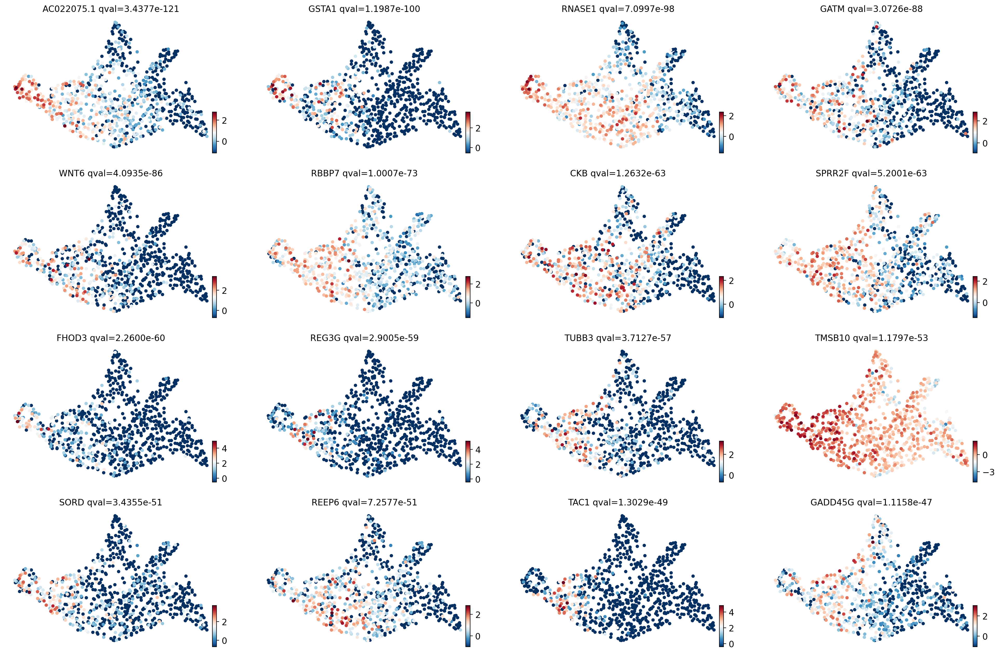

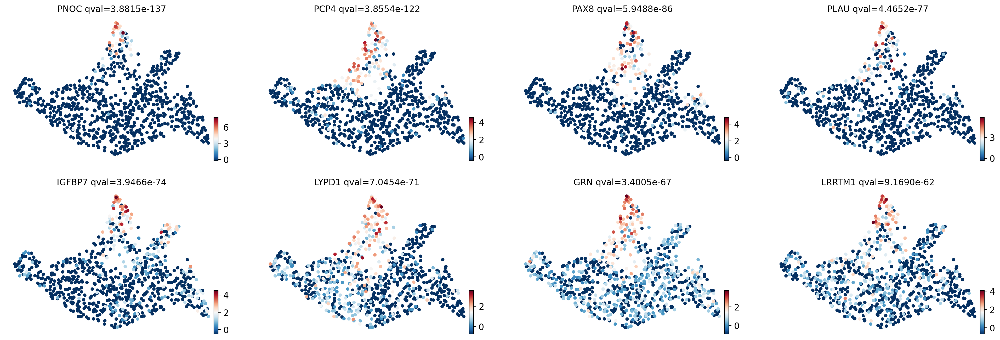

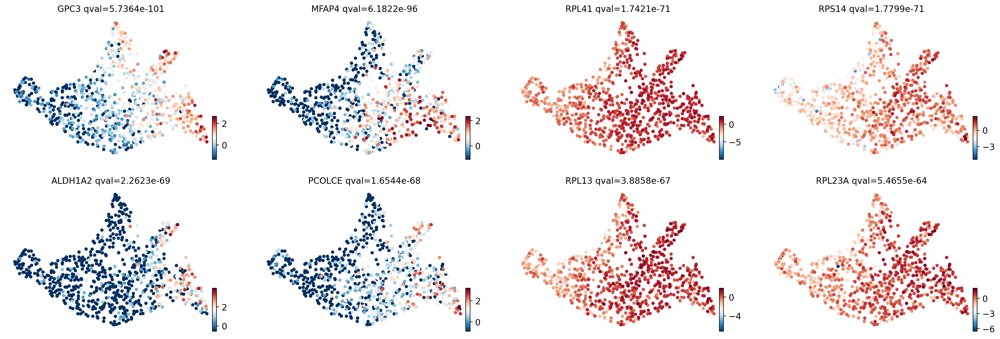

In [53]:
cr.pl.lineage_drivers(adataN, lineage="Sertoli", n_genes=16)
cr.pl.lineage_drivers(adataN, lineage="early_sPAX8", n_genes=8)
cr.pl.lineage_drivers(adataN, lineage="Gi", n_genes=8)

## Gene expression trends

The functions demonstrated above are the main functions of CellRank: computing initial and terminal states and probabilistic fate maps. We can use the computed probabilities now to e.g. smooth gene expression trends along lineages.

Let’s start with a temporal ordering for the cells. To get this, we can compute scVelo’s latent time, as computed previously, or alternatively, we can just use CellRank’s initial states to compute a [Haghverdi et al., 2016].

In [54]:
adataN.obs.head()

,n_genes,sample,donor,location,stage,sex,study,batch_collection,enrichment,cryopreserved,...,initial_size_unspliced,initial_size,velocity_self_transition,terminal_states,terminal_states_probs,clusters_gradients,initial_states,initial_states_probs,velocity_pseudotime,latent_time
FCA_GND8810851_AAACCTGGTAGCGATG,4779,FCA_GND8810851,Hrv17,Gonad_and_extragonadal,7.0,male,FCA,I,total,No,...,2816.0,24200.0,0.226230,Sertoli,0.998870,Sertoli,NaN,0.000143,0.918576,0.990210
FCA_GND8810851_AAACCTGTCTTTCCTC,1996,FCA_GND8810851,Hrv17,Gonad_and_extragonadal,7.0,male,FCA,I,total,No,...,555.0,6848.0,0.036850,NaN,0.892691,Sertoli,NaN,0.002915,0.390627,0.559302
FCA_GND8810851_AAAGATGGTGCGATAG,4111,FCA_GND8810851,Hrv17,Gonad_and_extragonadal,7.0,male,FCA,I,total,No,...,1831.0,21744.0,0.101115,NaN,0.741717,Gi,NaN,0.089294,0.102983,0.200844
FCA_GND8810851_AAATGCCGTACCGGCT,1964,FCA_GND8810851,Hrv17,Gonad_and_extragonadal,7.0,male,FCA,I,total,No,...,796.0,6292.0,0.102839,NaN,0.990408,Gi,NaN,0.000981,0.078940,0.344067
FCA_GND8810851_AAATGCCGTGGAAAGA,2284,FCA_GND8810851,Hrv17,Gonad_and_extragonadal,7.0,male,FCA,I,total,No,...,673.0,8921.0,0.026327,NaN,0.989326,Gi,NaN,0.005655,0.078155,0.229329


/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


saving figure to file ./figures/scvelo__Hrv17_cellRank_dynamics.pdf


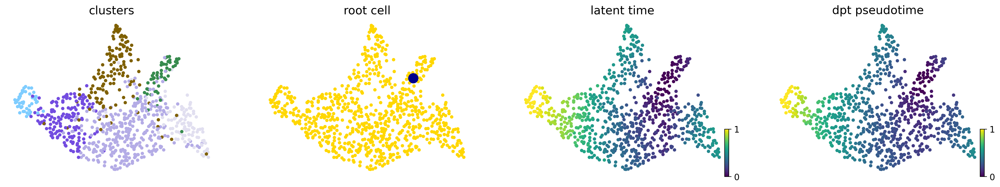

In [55]:
# compue DPT, starting from CellRank defined root cell
root_idx = np.where(adataN.obs["initial_states"] == "early_somatic")[0][0]
adataN.uns["iroot"] = root_idx
sc.tl.dpt(adataN)

scv.pl.scatter(
    adataN,
    color=["clusters", root_idx, "latent_time", "dpt_pseudotime"],
    fontsize=16,
    cmap="viridis",
    perc=[2, 98],
    colorbar=True,
    rescale_color=[0, 1],
    title=["clusters", "root cell", "latent time", "dpt pseudotime"],
    save= '_Hrv17_cellRank_dynamics.pdf'
)


We can plot dynamics of genes in pseudotime along individual trajectories, defined via the fate maps we computed above.

/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
  0%|          | 0/8 [00:00<?, ?gene/s]/home/jovyan/my-conda-envs/cellRank/lib/python3.8/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  base

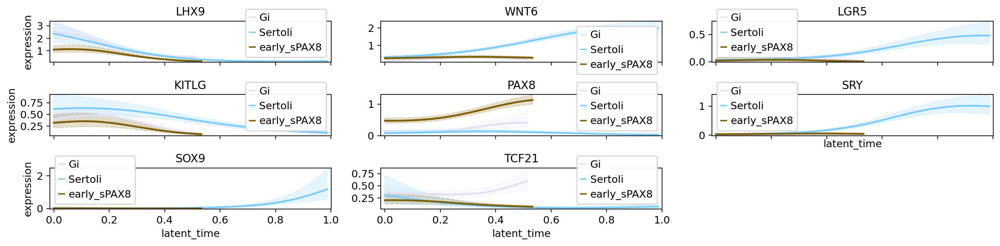

In [56]:
adataN = adataN.raw.to_adata()
model = cr.ul.models.GAM(adataN)
cr.pl.gene_trends(
    adataN,
    model=model,
    data_key="X",
    genes=["LHX9", 'WNT6',  'LGR5', 'KITLG', "PAX8", "SRY", "SOX9",  'TCF21'],
    ncols=3,
    time_key="latent_time",
    same_plot=True,
    hide_cells=True,
    figsize=(15, 4),
    n_test_points=200,
)

We can also visualize the lineage drivers computed above in a heatmap. Below, we do this for the supporting lineage, i.e. we smooth gene expression for the putative Sertoli-drivers in pseudotime, using as cell-level weights the Sertoli fate probabilities. We sort genes according to their peak in pseudotime, thus revealing a cascade of gene expression events.

In [58]:
# cr.pl.heatmap(
#     adataN,
#     model,
#     genes=adataN.varm['terminal_lineage_drivers']["Sertoli_corr"].sort_values(ascending=False).index[:100],
#     show_absorption_probabilities=True,
#     lineages="Sertoli",
#     n_jobs=1,
#     backend="loky",
# )

In [59]:
# Barplot('phase', adata, var='celltype', height=1.5)